In [1]:
import pandas as pd
import numpy as np
import scipy.stats as stats
import seaborn as sns
import matplotlib.pyplot as plt
import statsmodels.api as sm
import statsmodels.api as sm
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import LinearRegression

In [2]:
data = pd.read_csv("C:\\Users\\rushi\\Desktop\\Python_FORE\\CSV Files\\Project Dataset.csv")

In [3]:
sd = data.sample(n=3001, random_state = 55027)

In [4]:
ncd = sd[['Quantity', 'Value', 'Date' , 'Weight']]


Shapiro-Wilk Test for Quantity -
 Statistic: 0.9562371584198965, p-value: 3.953088543988808e-29



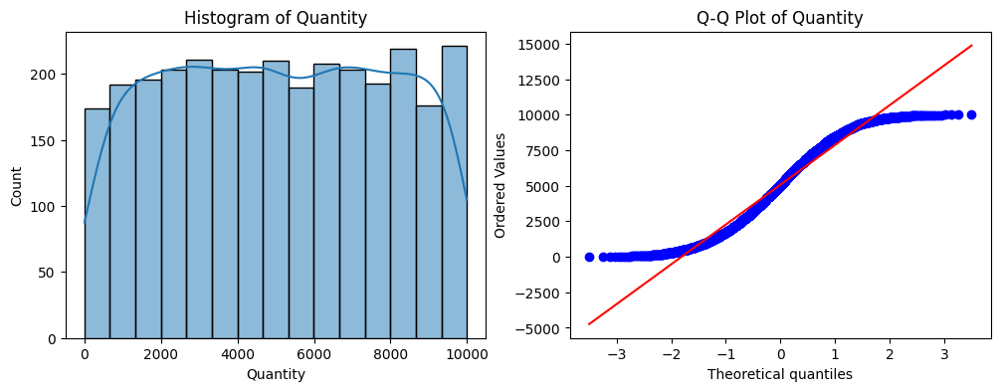

Shapiro-Wilk Test for Value -
 Statistic: 0.9569306674445125, p-value: 6.274870514376385e-29



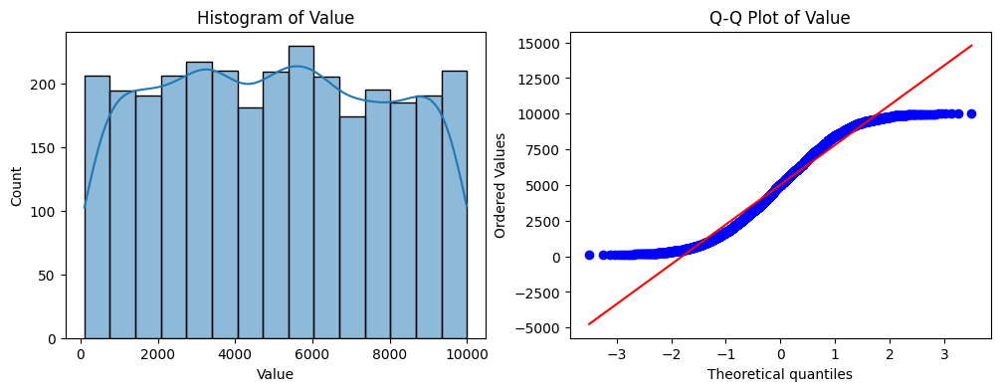

Shapiro-Wilk Test for Weight -
 Statistic: 0.9539161085792937, p-value: 8.764401575685593e-30



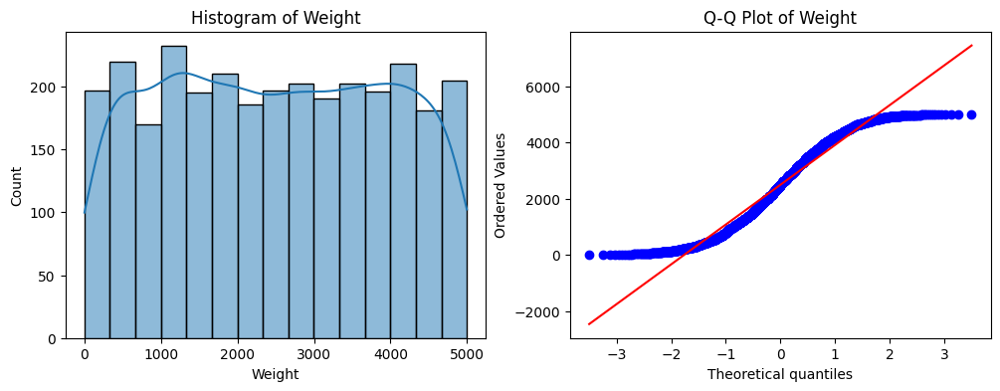

Kolmogorov-Smirnov Test for Quantity -
 KS Statistic: 0.05932038536421402, p-value: 1.2729751211988466e-09



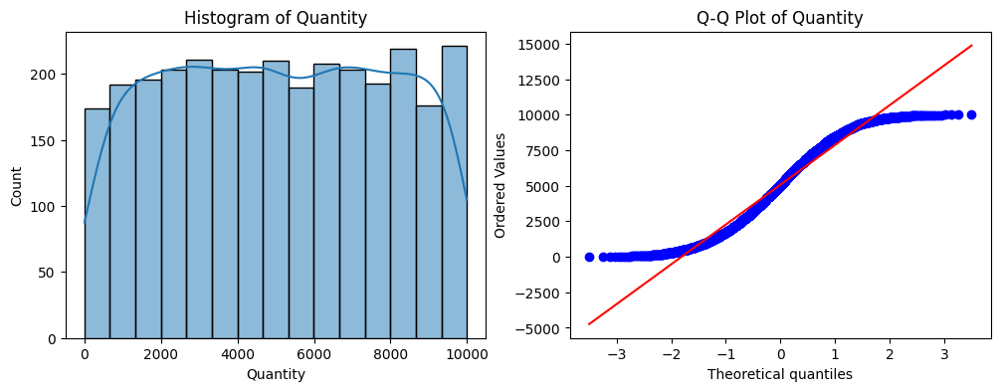

Kolmogorov-Smirnov Test for Value -
 KS Statistic: 0.054788276656475454, p-value: 2.8577445949959174e-08



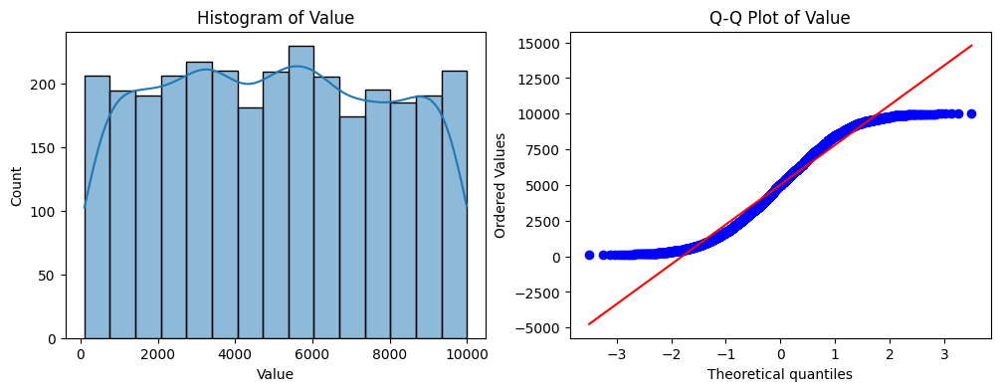

Kolmogorov-Smirnov Test for Weight -
 KS Statistic: 0.06450650293738291, p-value: 2.6707945821082337e-11



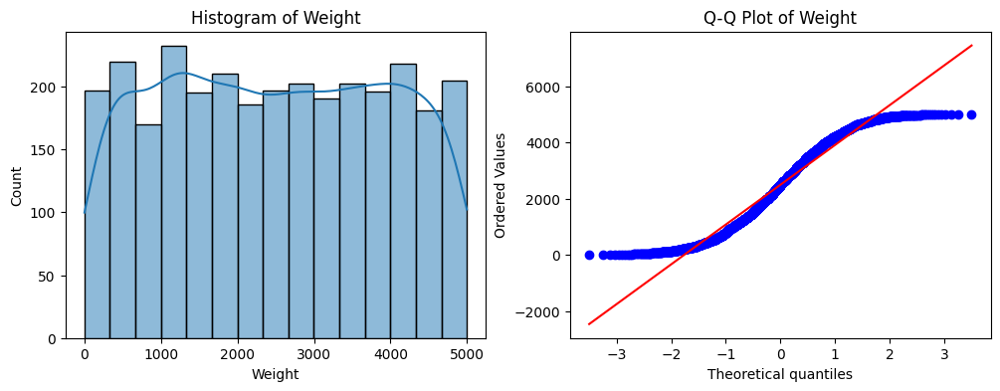

Anderson-Darling Test for Quantity -
 Statistic: 32.37963931298782,
 Critical Values: [0.575 0.655 0.786 0.917 1.091],
 Significance Levels: [15.  10.   5.   2.5  1. ]



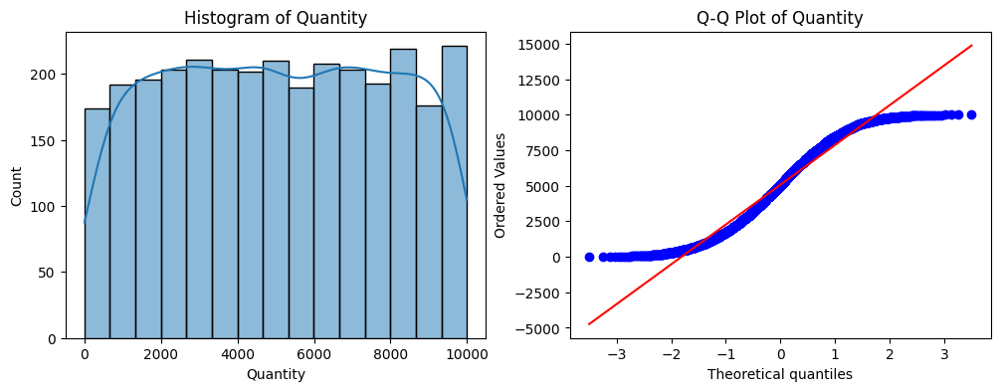

Anderson-Darling Test for Value -
 Statistic: 30.31671332888527,
 Critical Values: [0.575 0.655 0.786 0.917 1.091],
 Significance Levels: [15.  10.   5.   2.5  1. ]



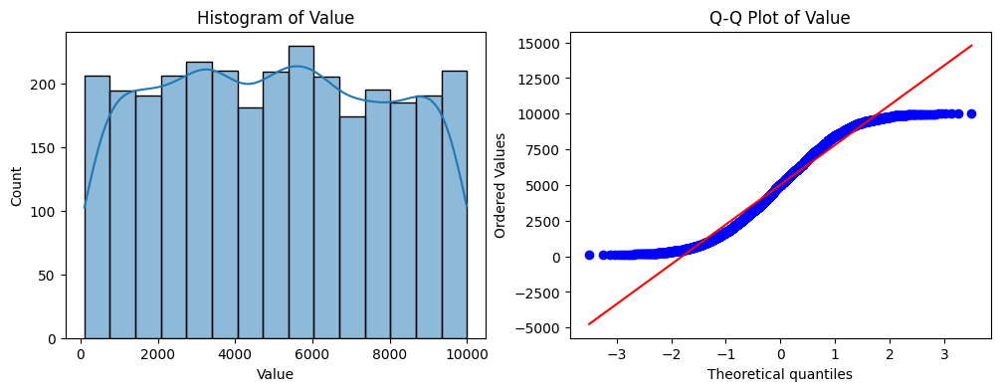

Anderson-Darling Test for Weight -
 Statistic: 34.69633148054254,
 Critical Values: [0.575 0.655 0.786 0.917 1.091],
 Significance Levels: [15.  10.   5.   2.5  1. ]



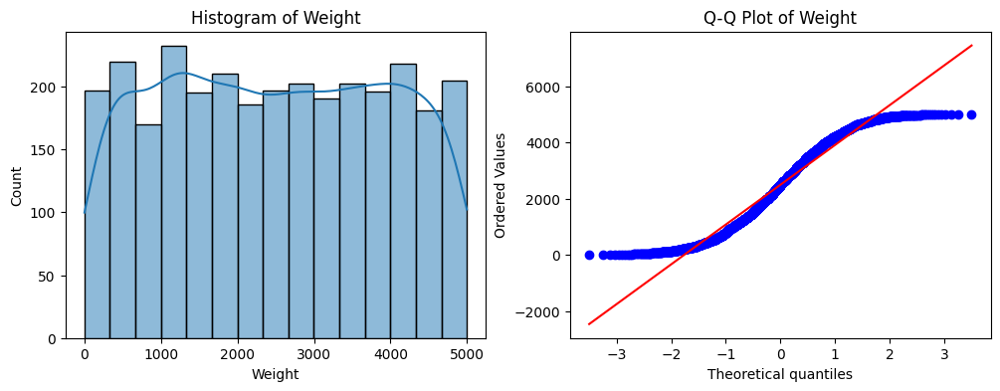

Jarque-Bera Test for Quantity -
 Statistic: 177.15925490262887, p-value: 3.3912248724985087e-39



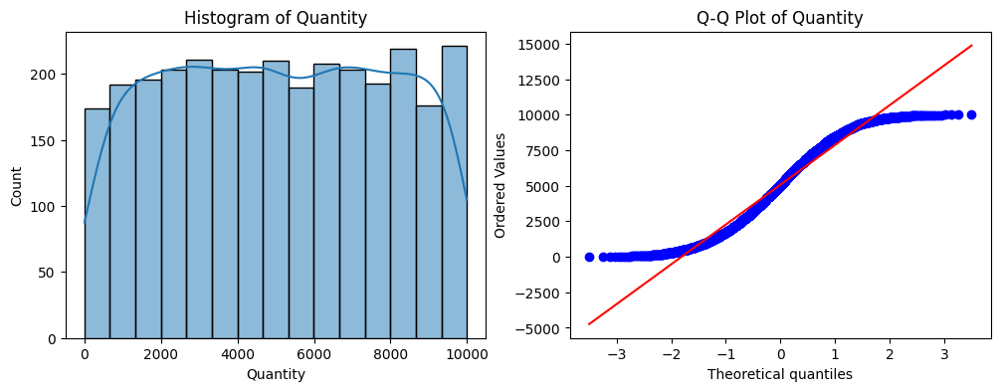

Jarque-Bera Test for Value -
 Statistic: 171.32356012787483, p-value: 6.274246949925584e-38



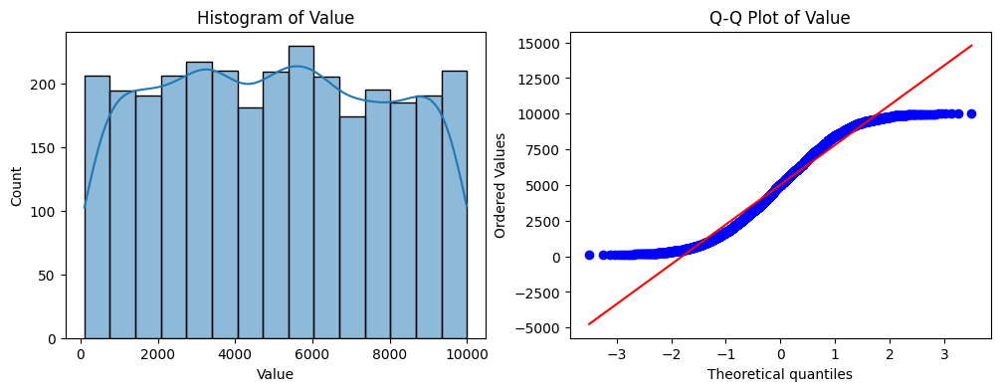

Jarque-Bera Test for Weight -
 Statistic: 183.11457324326756, p-value: 1.726536015649313e-40



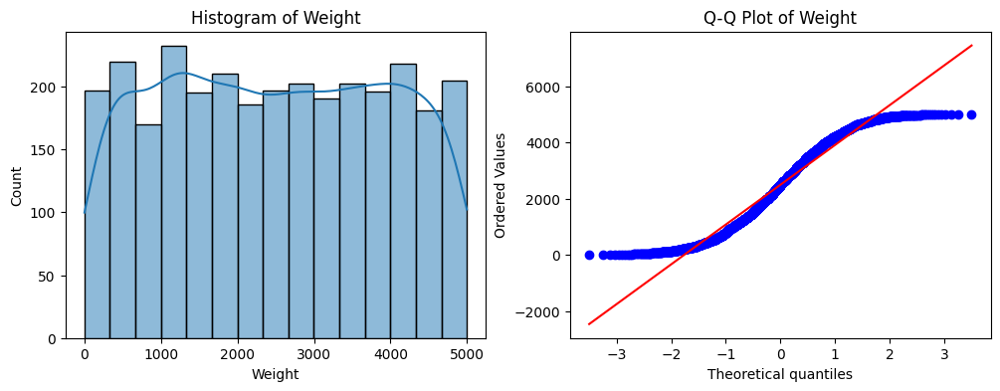

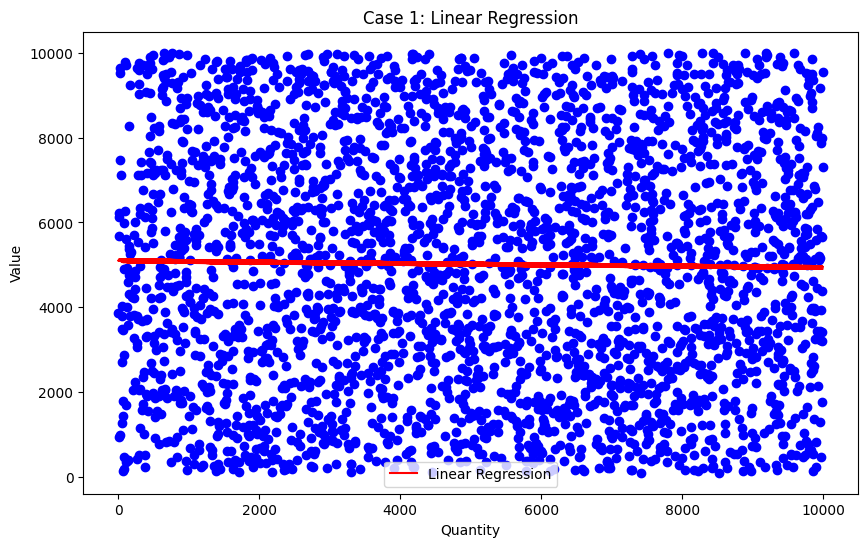

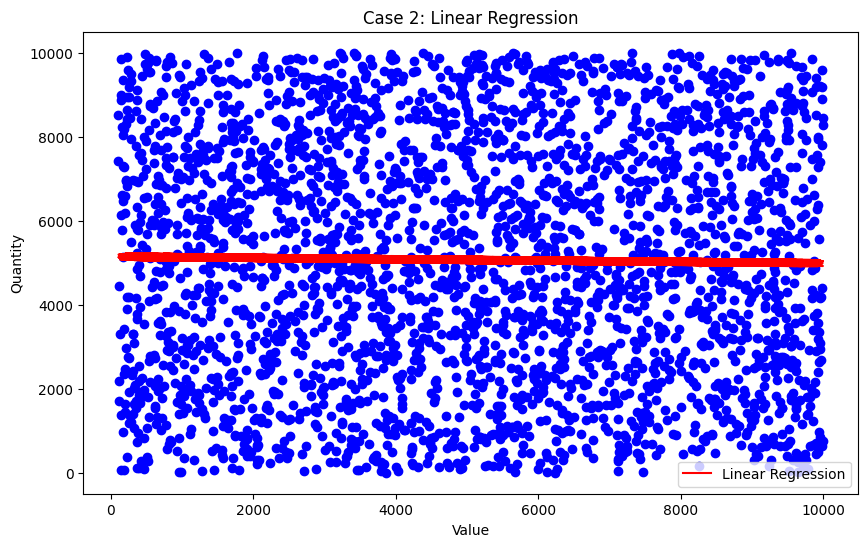

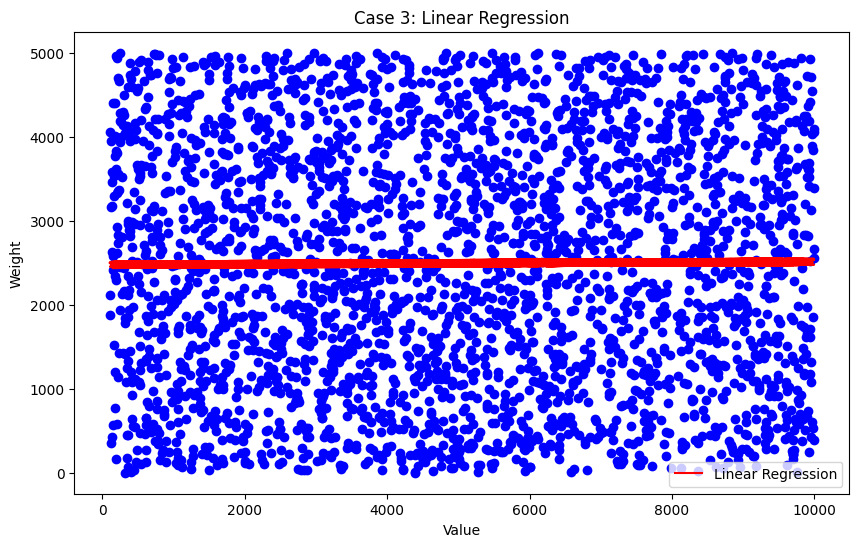

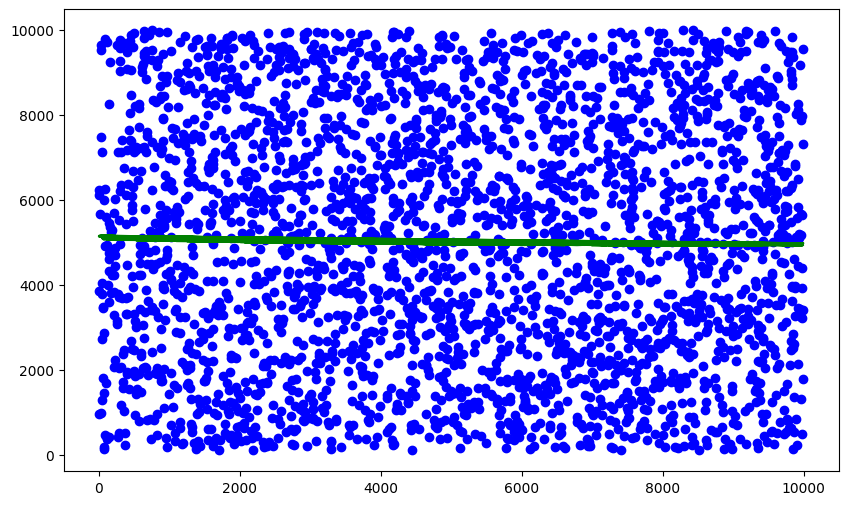

...

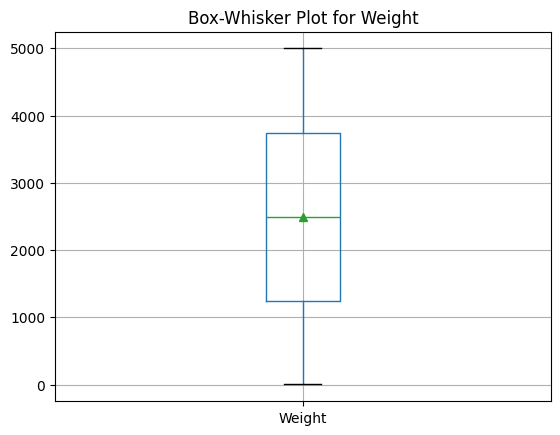

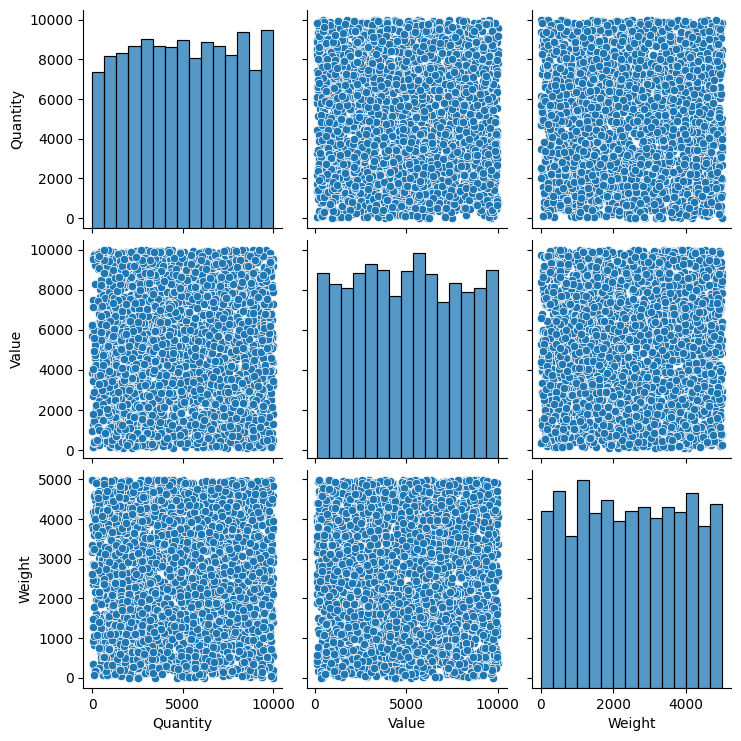

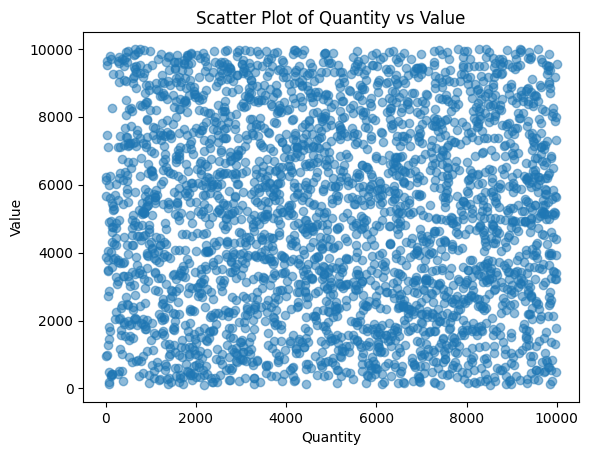

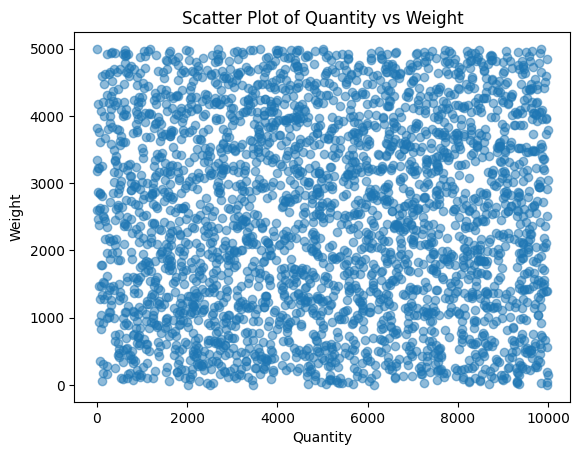

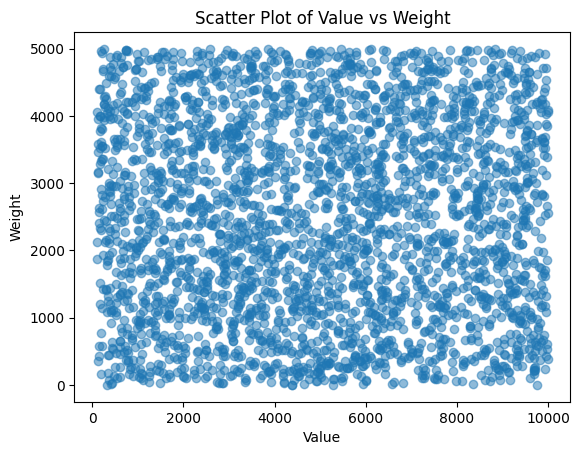

C:\Users\rushi\AppData\Local\Temp\ipykernel_7972\3455136881.py:263: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  ncd['Date'] = pd.to_datetime(ncd['Date'], format='%d-%m-%Y')


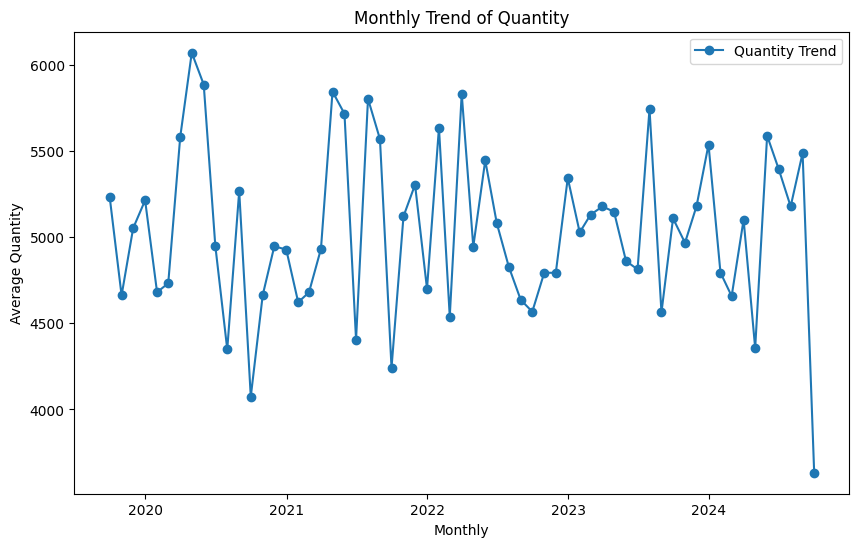

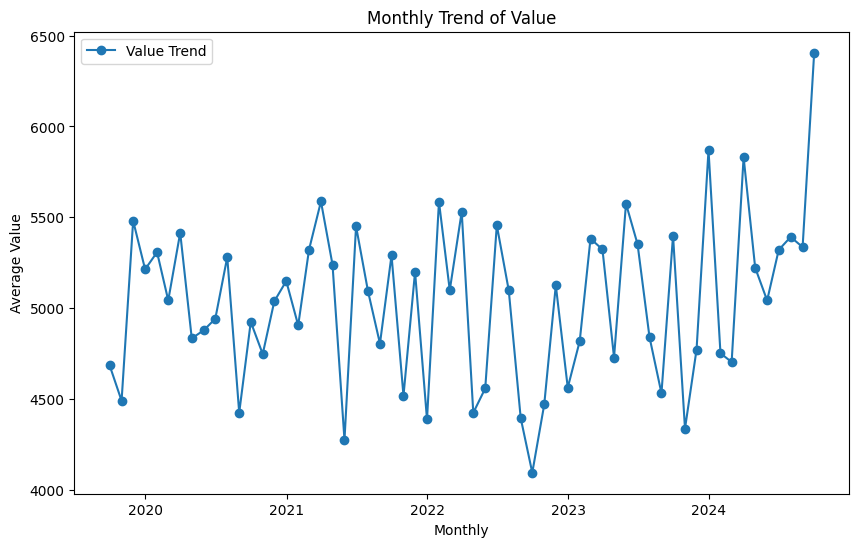

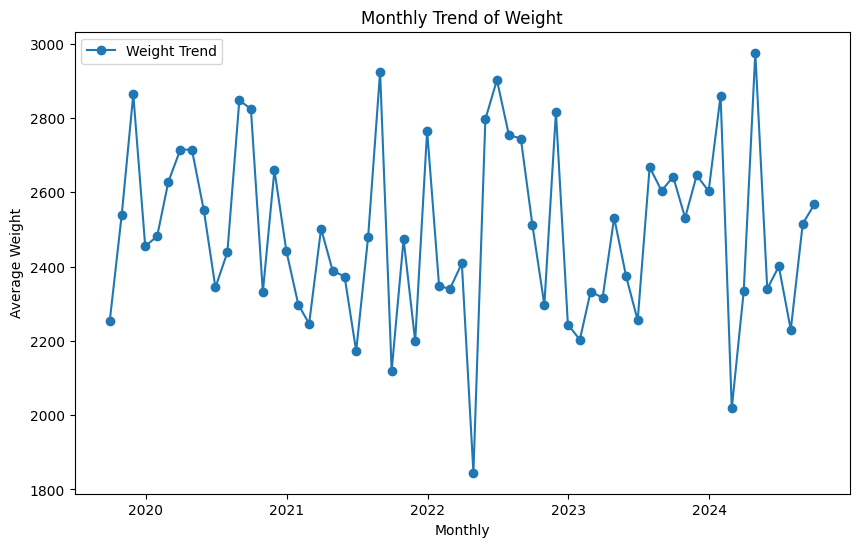

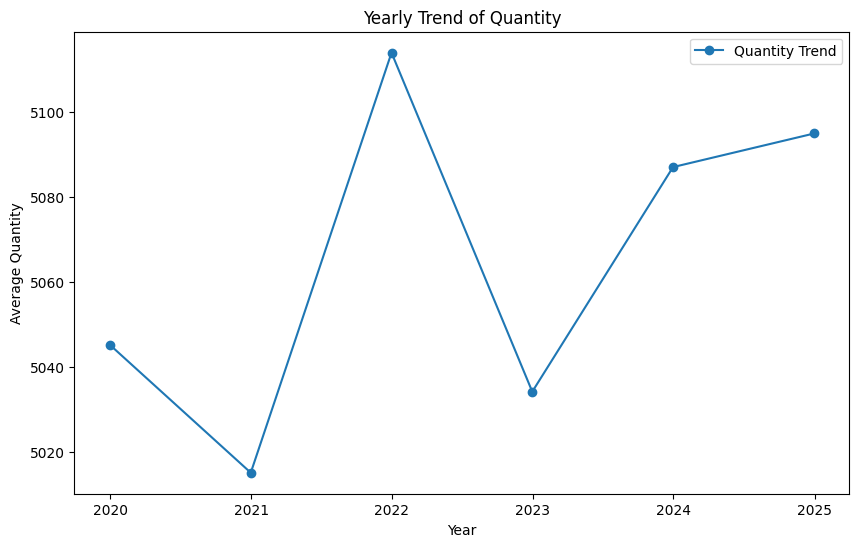

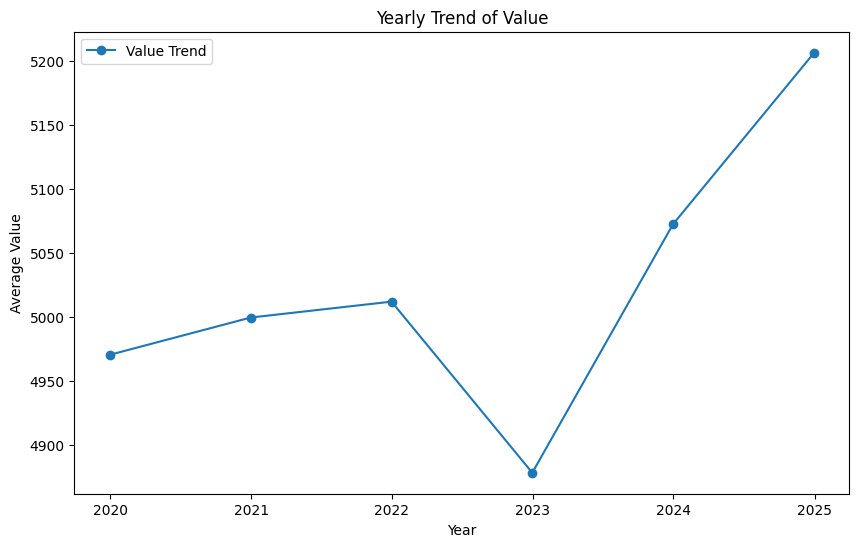

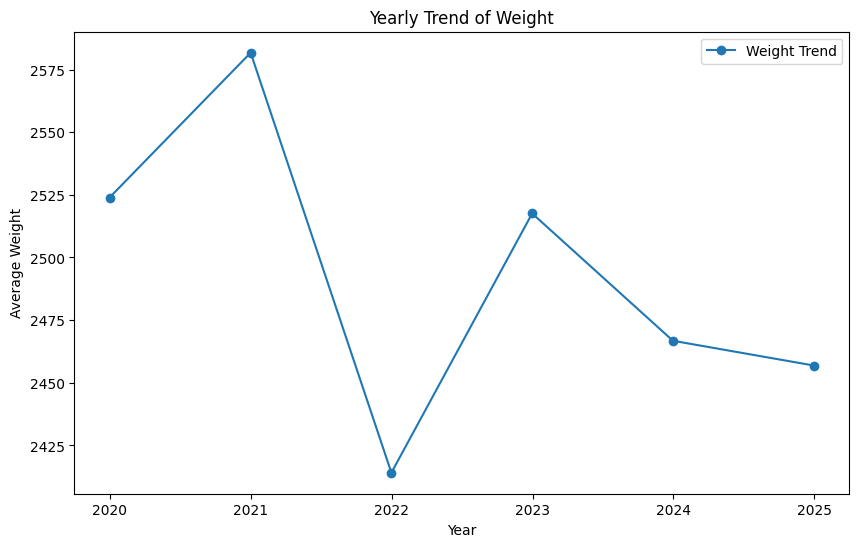

Test of Correlation:
           Quantity     Value    Weight      Date
Quantity  1.000000 -0.015586  0.015742  0.003717
Value    -0.015586  1.000000  0.006636  0.011251
Weight    0.015742  0.006636  1.000000 -0.014018
Date      0.003717  0.011251 -0.014018  1.000000


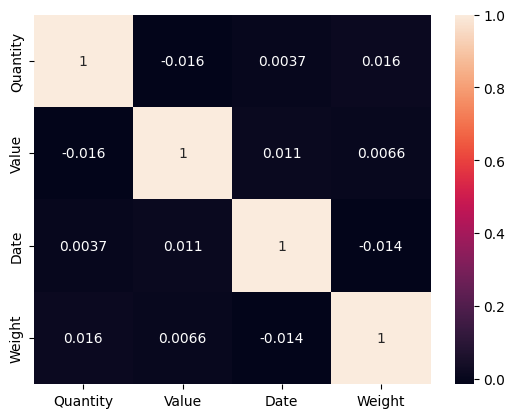

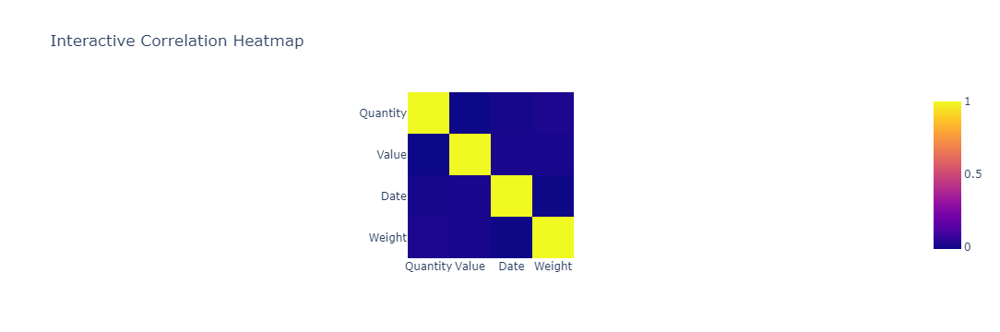

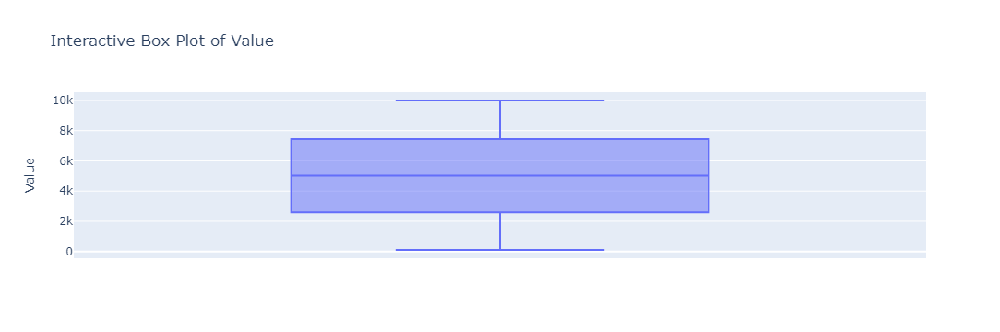

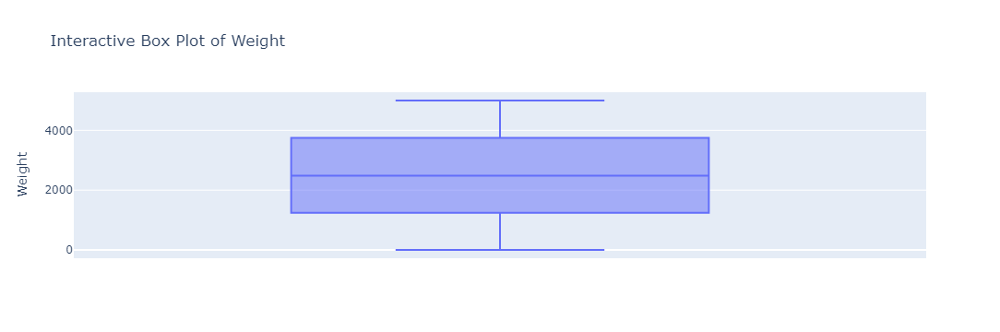

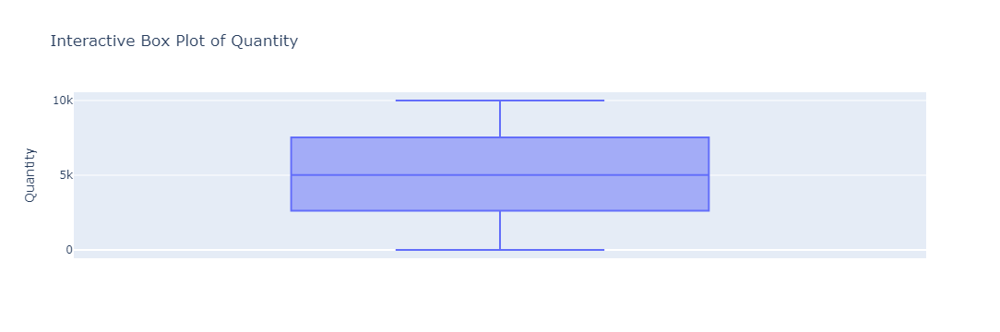

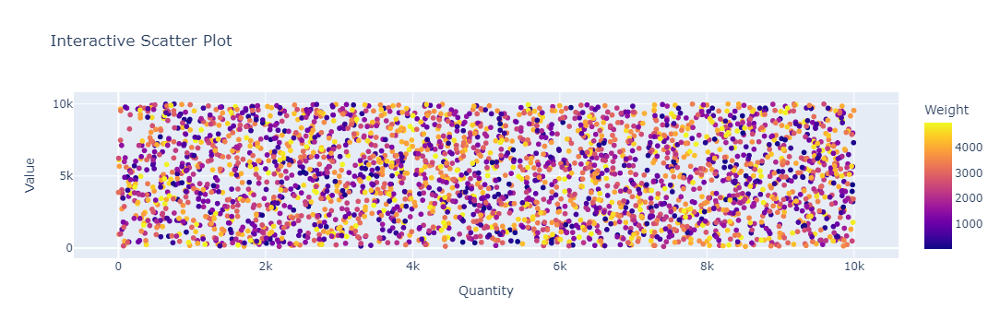

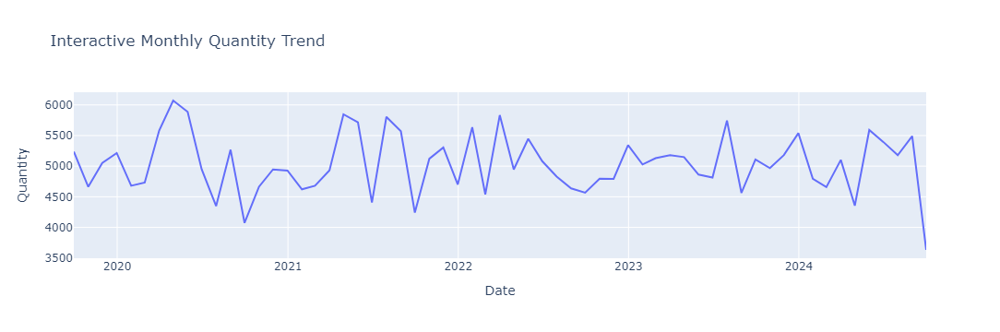

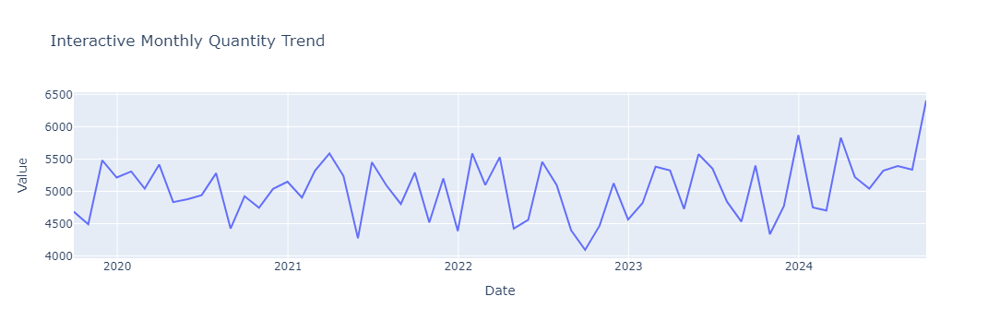

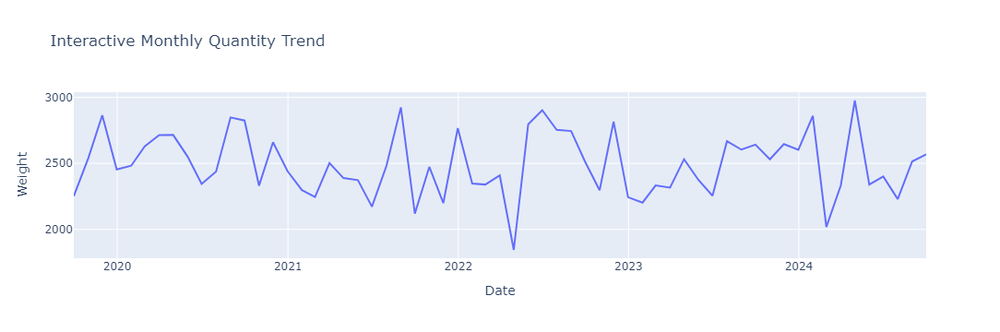

In [5]:
# visualization
import matplotlib.pyplot as plt
import seaborn as sns
import scipy.stats as stats

# Shapiro-Wilk test for normality
for col in ['Quantity', 'Value', 'Weight']:
    stat, p = stats.shapiro(ncd[col])
    print(f"Shapiro-Wilk Test for {col} -\n Statistic: {stat}, p-value: {p}\n")

    # Visualize with histogram and Q-Q plot
    plt.figure(figsize=(12, 4))

    plt.subplot(1, 2, 1)
    sns.histplot(ncd[col], kde=True)
    plt.title(f'Histogram of {col}')

    plt.subplot(1, 2, 2)
    stats.probplot(ncd[col], dist="norm", plot=plt)
    plt.title(f'Q-Q Plot of {col}')

    plt.show()

# Kolmogorov-Smirnov test for normality
for col in ['Quantity', 'Value', 'Weight']:
    ks_stat, ks_p = stats.kstest(ncd[col], 'norm', args=(ncd[col].mean(), ncd[col].std()))
    print(f"Kolmogorov-Smirnov Test for {col} -\n KS Statistic: {ks_stat}, p-value: {ks_p}\n")

    # Visualize with histogram and Q-Q plot
    plt.figure(figsize=(12, 4))

    plt.subplot(1, 2, 1)
    sns.histplot(ncd[col], kde=True)
    plt.title(f'Histogram of {col}')

    plt.subplot(1, 2, 2)
    stats.probplot(ncd[col], dist="norm", plot=plt)
    plt.title(f'Q-Q Plot of {col}')

    plt.show()

# Anderson-Darling test for normality
for col in ['Quantity', 'Value', 'Weight']:
    result = stats.anderson(ncd[col])
    print(f"Anderson-Darling Test for {col} -\n Statistic: {result.statistic},\n Critical Values: {result.critical_values},\n Significance Levels: {result.significance_level}\n")

    # Visualize with histogram and Q-Q plot
    plt.figure(figsize=(12, 4))

    plt.subplot(1, 2, 1)
    sns.histplot(ncd[col], kde=True)
    plt.title(f'Histogram of {col}')

    plt.subplot(1, 2, 2)
    stats.probplot(ncd[col], dist="norm", plot=plt)
    plt.title(f'Q-Q Plot of {col}')

    plt.show()

# Jarque-Bera Test for normality
for col in ['Quantity', 'Value', 'Weight']:
    jb_stat, jb_p = stats.jarque_bera(ncd[col])
    print(f"Jarque-Bera Test for {col} -\n Statistic: {jb_stat}, p-value: {jb_p}\n")

    # Visualize with histogram and Q-Q plot
    plt.figure(figsize=(12, 4))

    plt.subplot(1, 2, 1)
    sns.histplot(ncd[col], kde=True)
    plt.title(f'Histogram of {col}')

    plt.subplot(1, 2, 2)
    stats.probplot(ncd[col], dist="norm", plot=plt)
    plt.title(f'Q-Q Plot of {col}')

    plt.show()

# Linear Regression
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression

# Case 1: Value as dependent variable
X = ncd[['Quantity', 'Weight']]
y = ncd['Value']

# Linear Regression
lin_reg = LinearRegression()
lin_reg.fit(X, y)
y_pred_lin = lin_reg.predict(X)

# Plotting
plt.figure(figsize=(10, 6))
plt.scatter(X['Quantity'], y, color='blue')
plt.plot(X['Quantity'], y_pred_lin, color='red', label='Linear Regression')
plt.xlabel('Quantity')
plt.ylabel('Value')
plt.title('Case 1: Linear Regression')
plt.legend()
plt.show()

# Case 2: Quantity as dependent variable
X = ncd[['Value', 'Weight']]
y = ncd['Quantity']

# Linear Regression
lin_reg = LinearRegression()
lin_reg.fit(X, y)
y_pred_lin = lin_reg.predict(X)

# Plotting
plt.figure(figsize=(10, 6))
plt.scatter(X['Value'], y, color='blue')
plt.plot(X['Value'], y_pred_lin, color='red', label='Linear Regression')
plt.xlabel('Value')
plt.ylabel('Quantity')
plt.title('Case 2: Linear Regression')
plt.legend()
plt.show()

# Case 3: Weight as dependent variable
X = ncd[['Value', 'Quantity']]
y = ncd['Weight']

# Linear Regression
lin_reg = LinearRegression()
lin_reg.fit(X, y)
y_pred_lin = lin_reg.predict(X)

# Plotting
plt.figure(figsize=(10, 6))
plt.scatter(X['Value'], y, color='blue')
plt.plot(X['Value'], y_pred_lin, color='red', label='Linear Regression')
plt.xlabel('Value')
plt.ylabel('Weight')
plt.title('Case 3: Linear Regression')
plt.legend()
plt.show()

# Polynomial Regression
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import PolynomialFeatures

# Case 1: Value as dependent variable
X = ncd[['Quantity', 'Weight']]
y = ncd['Value']

# Polynomial Regression
poly = PolynomialFeatures(degree=2)
X_poly = poly.fit_transform(X)
poly_reg = LinearRegression()
poly_reg.fit(X_poly, y)
y_pred_poly = poly_reg.predict(X_poly)

# Plotting
plt.figure(figsize=(10, 6))
plt.scatter(X['Quantity'], y, color='blue')
plt.plot(X['Quantity'], y_pred_poly, color='green', label='Polynomial Regression')
# Polynomial Regression
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import PolynomialFeatures

# Case 1: Value as dependent variable
X = ncd[['Quantity', 'Weight']]
y = ncd['Value']

# Polynomial Regression
poly = PolynomialFeatures(degree=2)
X_poly = poly.fit_transform(X)
poly_reg = LinearRegression()
poly_reg.fit(X_poly, y)
y_pred_poly = poly_reg.predict(X_poly)

# Plotting
plt.figure(figsize=(10, 6))
plt.scatter(X['Quantity'], y, color='blue')
plt.plot(X['Quantity'], y_pred_poly, color='green', label='Polynomial Regression')
plt.xlabel('Quantity')
plt.ylabel('Value')
plt.title('Case 1: Polynomial Regression')
plt.legend()
plt.show()

# Case 2: Quantity as dependent variable
X = ncd[['Value', 'Weight']]
y = ncd['Quantity']

# Polynomial Regression
poly = PolynomialFeatures(degree=2)
X_poly = poly.fit_transform(X)
poly_reg = LinearRegression()
poly_reg.fit(X_poly, y)
y_pred_poly = poly_reg.predict(X_poly)

# Plotting
plt.figure(figsize=(10, 6))
plt.scatter(X['Value'], y, color='blue')
plt.plot(X['Value'], y_pred_poly, color='green', label='Polynomial Regression')
plt.xlabel('Value')
plt.ylabel('Quantity')
plt.title('Case 2: Polynomial Regression')
plt.legend()
plt.show()

# Case 3: Weight as dependent variable
X = ncd[['Value', 'Quantity']]
y = ncd['Weight']

# Polynomial Regression
poly = PolynomialFeatures(degree=2)
X_poly = poly.fit_transform(X)
poly_reg = LinearRegression()
poly_reg.fit(X_poly, y)
y_pred_poly = poly_reg.predict(X_poly)

# Plotting
plt.figure(figsize=(10, 6))
plt.scatter(X['Value'], y, color='blue')
plt.plot(X['Value'], y_pred_poly, color='green', label='Polynomial Regression')
plt.xlabel('Value')
plt.ylabel('Weight')
plt.title('Case 3: Polynomial Regression')
plt.legend()
plt.show()

ncd.boxplot(column=['Quantity', 'Value', 'Weight'], showmeans = True)
plt.title('Box-Whisker Plot for Quantity, Value, and Weight')
plt.show()

import matplotlib.pyplot as plt

# Create individual box plots for each numeric column in 'ncd'
for column in ncd.select_dtypes(include=np.number).columns:
  plt.figure()  # Create a new figure for each plot
  ncd.boxplot(column=[column], showmeans=True)
  plt.title(f'Box-Whisker Plot for {column}')
  plt.show()

sns.pairplot(ncd)
plt.show()

plt.scatter(ncd['Quantity'], ncd['Value'], alpha=0.5)
plt.xlabel('Quantity')
plt.ylabel('Value')
plt.title('Scatter Plot of Quantity vs Value')
plt.show()

plt.scatter(ncd['Quantity'], ncd['Weight'], alpha=0.5)
plt.xlabel('Quantity')
plt.ylabel('Weight')
plt.title('Scatter Plot of Quantity vs Weight')
plt.show()

plt.scatter(ncd['Value'], ncd['Weight'], alpha=0.5)
plt.xlabel('Value')
plt.ylabel('Weight')
plt.title('Scatter Plot of Value vs Weight')
plt.show()

#Monthly
# Convert 'Date' to datetime and sort
ncd['Date'] = pd.to_datetime(ncd['Date'], format='%d-%m-%Y')
ncd = ncd.sort_values(by='Date')

# Resample to monthly frequency and calculate the mean
monthly_data = ncd.resample('ME', on='Date').mean()

# Plot for Quantity
plt.figure(figsize=(10, 6))
plt.plot(monthly_data.index, monthly_data['Quantity'], label='Quantity Trend', marker = 'o')
plt.xlabel('Monthly')
plt.ylabel('Average Quantity')
plt.title('Monthly Trend of Quantity')
plt.legend()
plt.show()

# Plot for Value
plt.figure(figsize=(10, 6))
plt.plot(monthly_data.index, monthly_data['Value'], label='Value Trend', marker = 'o')
plt.xlabel('Monthly')
plt.ylabel('Average Value')
plt.title('Monthly Trend of Value')
plt.legend()
plt.show()

# Plot for Weight
plt.figure(figsize=(10, 6))
plt.plot(monthly_data.index, monthly_data['Weight'], label='Weight Trend', marker = 'o')
plt.xlabel('Monthly')
plt.ylabel('Average Weight')
plt.title('Monthly Trend of Weight')
plt.legend()
plt.show()

# Yearly
# Convert 'Date' to datetime and sort
ncd['Date'] = pd.to_datetime(ncd['Date'], format='%d-%m-%Y')
ncd = ncd.sort_values(by='Date')

# Resample to yearly frequency and calculate the mean
yearly_data = ncd.resample('YE', on='Date').mean()

# Plot for Quantity
plt.figure(figsize=(10, 6))
plt.plot(yearly_data.index, yearly_data['Quantity'], label='Quantity Trend', marker='o')
plt.xlabel('Year')
plt.ylabel('Average Quantity')
plt.title('Yearly Trend of Quantity')
plt.legend()
plt.show()

# Plot for Value
plt.figure(figsize=(10, 6))
plt.plot(yearly_data.index, yearly_data['Value'], label='Value Trend', marker='o')
plt.xlabel('Year')
plt.ylabel('Average Value')
plt.title('Yearly Trend of Value')
plt.legend()
plt.show()

# Plot for Weight
plt.figure(figsize=(10, 6))
plt.plot(yearly_data.index, yearly_data['Weight'], label='Weight Trend', marker='o')
plt.xlabel('Year')
plt.ylabel('Average Weight')
plt.title('Yearly Trend of Weight')
plt.legend()
plt.show()

#correlation Matrix
correlation_matrix = ncd[['Quantity', 'Value', 'Weight', 'Date']].corr()
print(f"Test of Correlation:\n {correlation_matrix}")

#correlation visualization heatmap
import seaborn as sns
import matplotlib.pyplot as plt

# Calculate the correlation matrix
corr_matrix = ncd.corr()

# Create the heatmap
sns.heatmap(corr_matrix, annot=True)
plt.show()

import plotly.express as px
import pandas as pd

# If corr_matrix is a NumPy array, convert it to a DataFrame
corr_matrix = pd.DataFrame(corr_matrix)

fig = px.imshow(corr_matrix.values,
                 x=corr_matrix.columns,
                 y=corr_matrix.index,
                 title='Interactive Correlation Heatmap')
fig.show()

import plotly.express as px
figv = px.box(ncd, y='Value', title='Interactive Box Plot of Value')
figv.show()

figw = px.box(ncd, y='Weight', title='Interactive Box Plot of Weight')
figw.show()

figq = px.box(ncd, y='Quantity', title='Interactive Box Plot of Quantity')
figq.show()

import plotly.express as px
fig = px.scatter(ncd, x='Quantity', y='Value', color='Weight',
                  hover_data=['Date'], title='Interactive Scatter Plot')
fig.show()

import plotly.express as px
figq = px.line(monthly_data, x=monthly_data.index, y='Quantity',
               title='Interactive Monthly Quantity Trend')
figq.show()

figv = px.line(monthly_data, x=monthly_data.index, y='Value',
               title='Interactive Monthly Quantity Trend')
figv.show()

figw = px.line(monthly_data, x=monthly_data.index, y='Weight',
               title='Interactive Monthly Quantity Trend')
figw.show()



###### 

In [14]:
sd = data.sample(n=3001 , random_state= 55027)

In [16]:
catd = sd[['Country','Product','Import_Export','Category','Port','Customs_Code','Shipping_Method','Supplier','Customer','Payment_Terms']]
catd.head()

,Country,Product,Import_Export,Category,Port,Customs_Code,Shipping_Method,Supplier,Customer,Payment_Terms
1288,Uganda,us,Import,Furniture,West Rachel,260760,Air,Harris-Miles,Kathryn Keith,Prepaid
6231,Bermuda,may,Import,Electronics,Walkerfurt,832337,Land,Bowers Inc,Chad Davis,Prepaid
4961,Niue,any,Export,Clothing,Connerport,643793,Land,Anderson PLC,Miss Terry Chavez,Cash on Delivery
3863,Isle of Man,serve,Import,Toys,East Jason,594706,Land,Mata-Mcpherson,Christina Donaldson,Cash on Delivery
2249,Jersey,wonder,Export,Clothing,West Kelly,767556,Air,"Vasquez, Johnson and Castro",Stephen Vasquez,Net 60


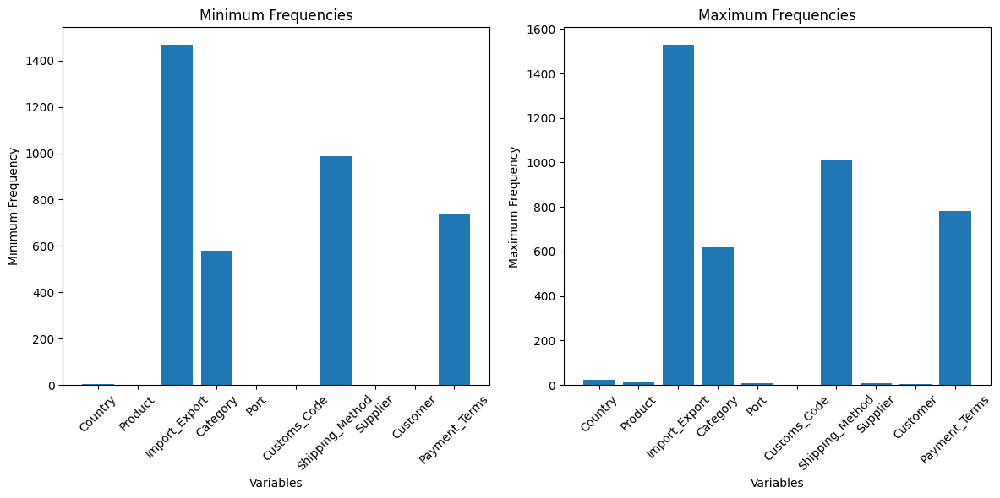

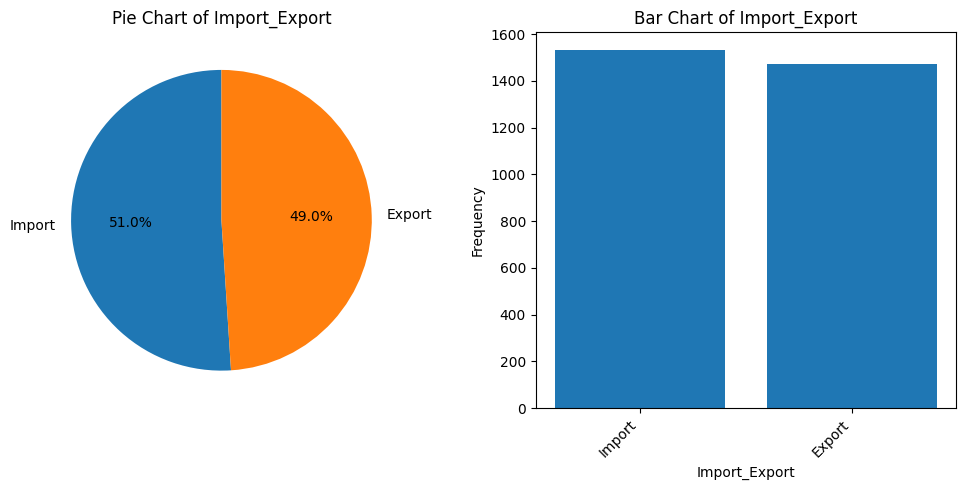

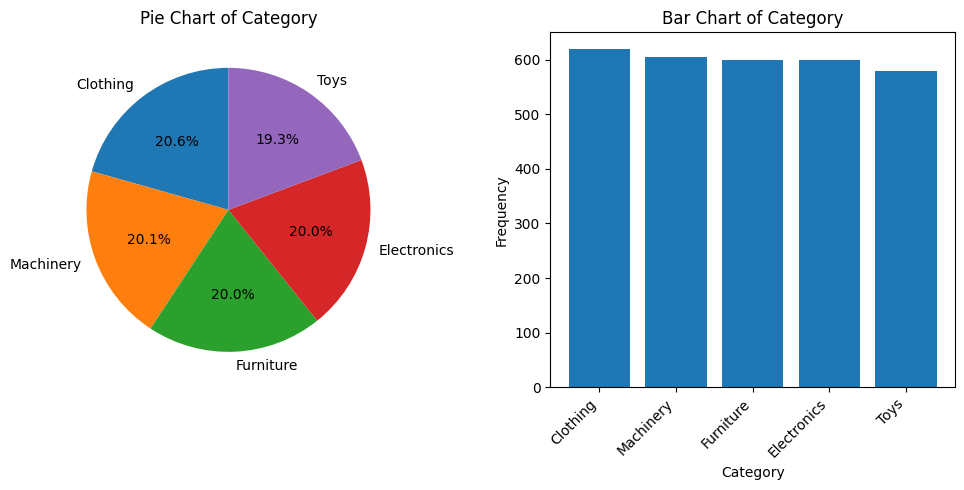

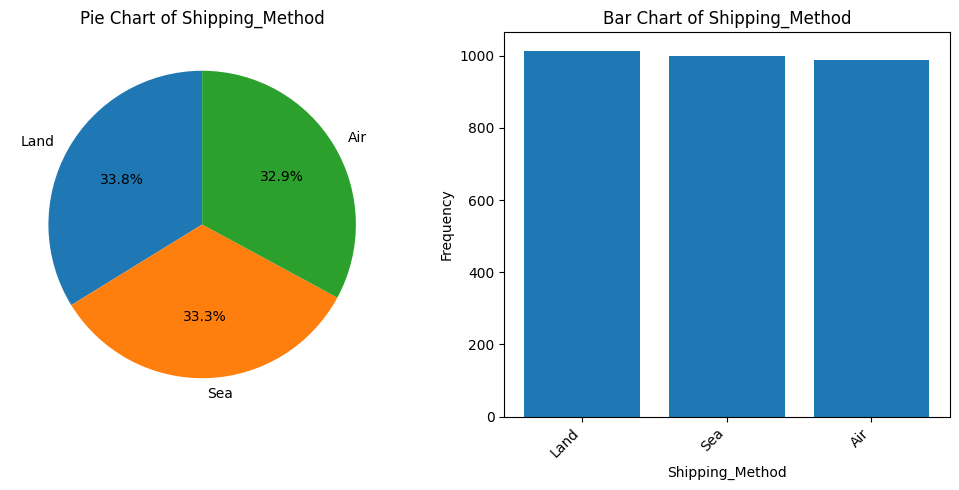

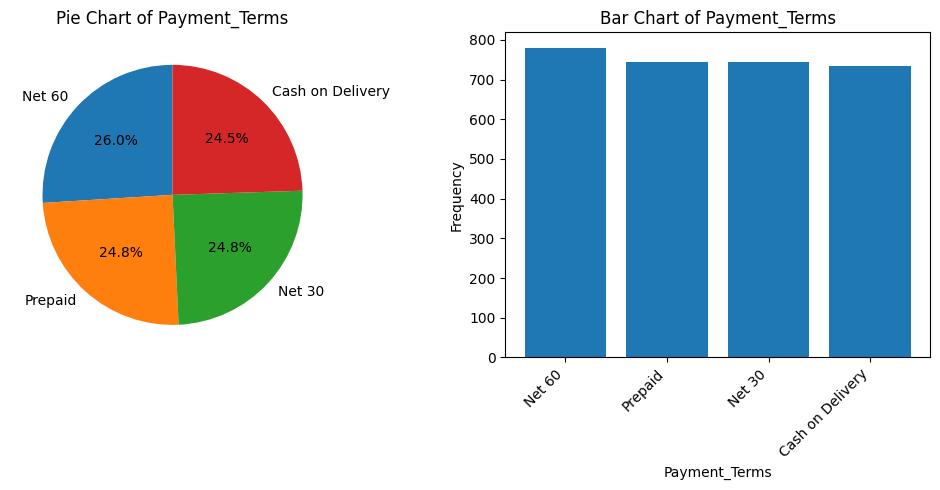

...

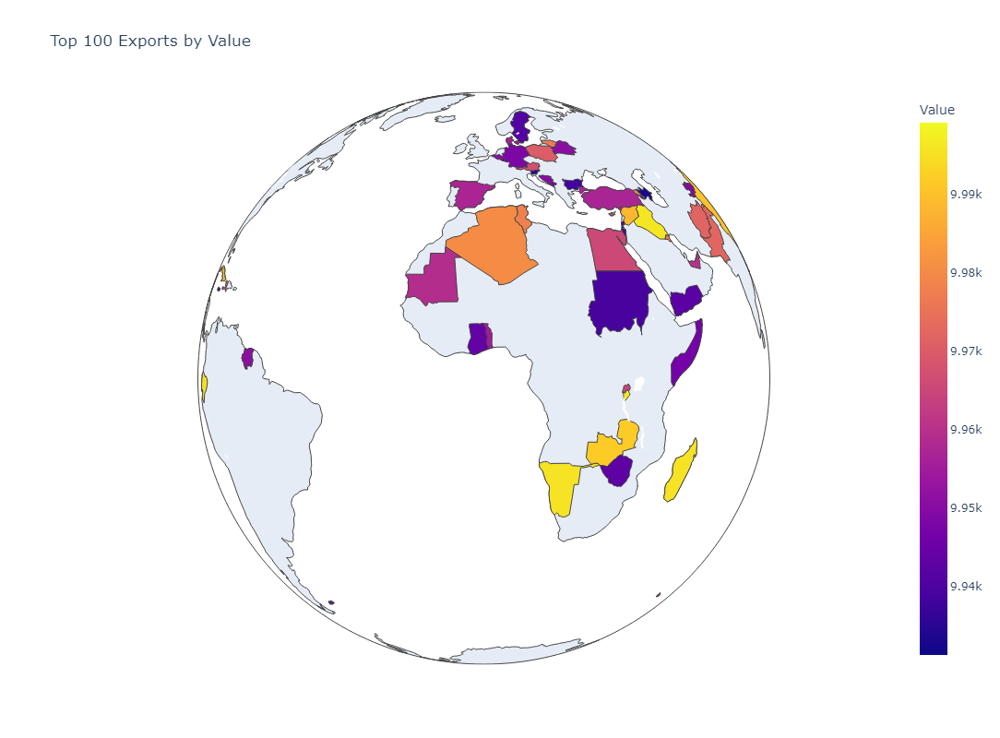

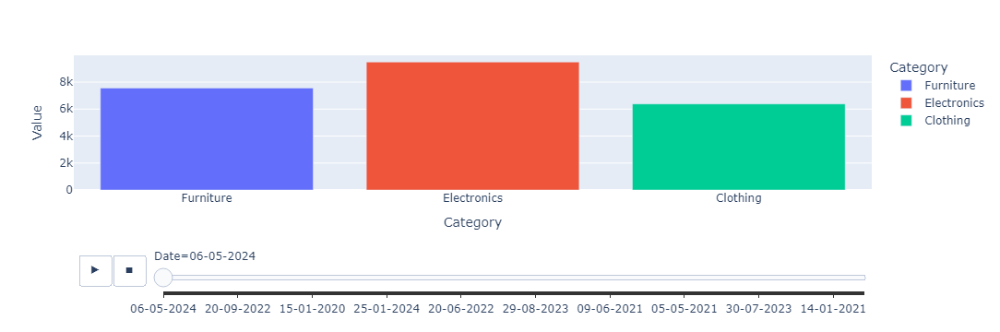

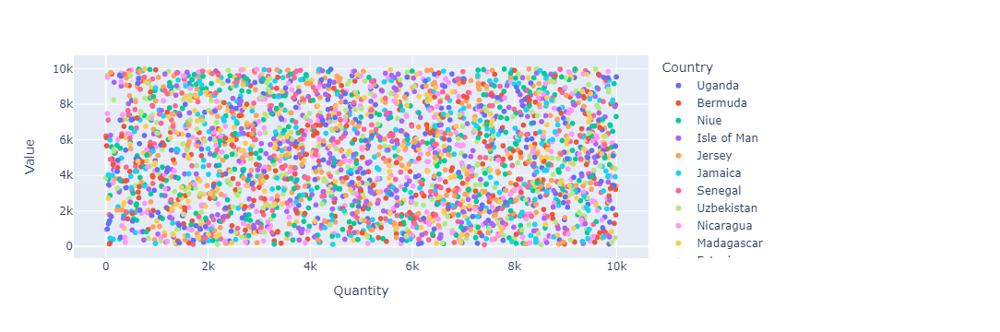

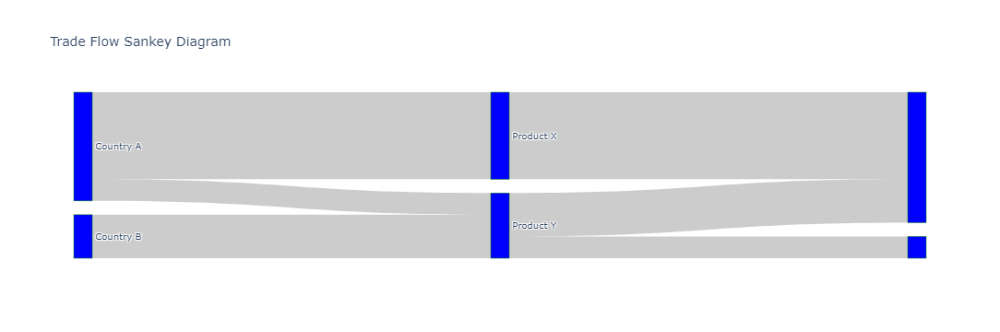

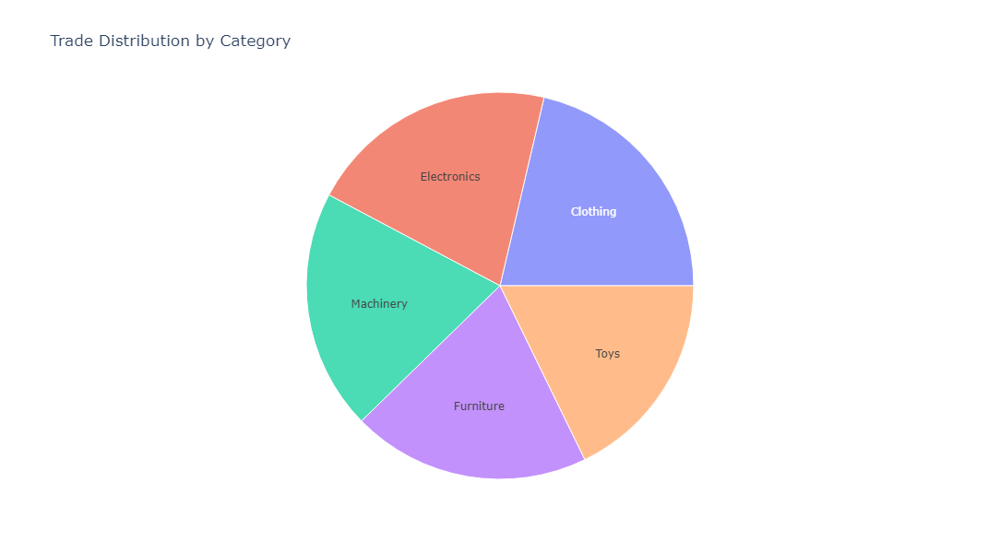

In [18]:
import matplotlib.pyplot as plt

# Create lists to store minimum and maximum frequencies
min_freqs = []
max_freqs = []

for col in catd.columns:
    value_counts = catd[col].value_counts()
    min_freqs.append(value_counts.min())
    max_freqs.append(value_counts.max())

# Create separate bar charts
plt.figure(figsize=(12, 6))

# Minimum Frequencies
plt.subplot(1, 2, 1)
plt.bar(catd.columns, min_freqs)
plt.xlabel('Variables')
plt.ylabel('Minimum Frequency')
plt.title('Minimum Frequencies')
plt.xticks(rotation=45)

# Maximum Frequencies
plt.subplot(1, 2, 2)
plt.bar(catd.columns, max_freqs)
plt.xlabel('Variables')
plt.ylabel('Maximum Frequency')
plt.title('Maximum Frequencies')
plt.xticks(rotation=45)

plt.tight_layout()
plt.show()

import matplotlib.pyplot as plt

# Assuming 'catd' is your DataFrame
sd = data.sample(n=3001 , random_state= 55027)
catd = sd[['Country','Product','Import_Export','Category','Port','Customs_Code','Weight','Shipping_Method','Supplier','Customer','Payment_Terms']]

# List of variables for pie and bar charts
variables = ['Import_Export', 'Category', 'Shipping_Method', 'Payment_Terms']

# Iterate over the specified variables
for var in variables:
  # Count the frequency of each category
  value_counts = catd[var].value_counts()

  # Pie chart
  plt.figure(figsize=(10, 5))
  plt.subplot(1, 2, 1)
  plt.pie(value_counts, labels=value_counts.index, autopct='%1.1f%%', startangle=90)
  plt.title(f'Pie Chart of {var}')

  # Bar chart
  plt.subplot(1, 2, 2)
  plt.bar(value_counts.index, value_counts.values)
  plt.xlabel(var)
  plt.ylabel('Frequency')
  plt.title(f'Bar Chart of {var}')
  plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for better readability

  plt.tight_layout()
  plt.show()


import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming 'catd' is your DataFrame with categorical data
sd = data.sample(n=3001, random_state=55027)
catd = sd[['Import_Export', 'Category',
            'Shipping_Method',
           'Payment_Terms']]

# Create histograms for each categorical variable
for column in catd.columns:
    plt.figure(figsize=(10, 6))  # Adjust figure size as needed
    sns.countplot(x=column, data=catd)
    plt.title(f'Histogram of {column}')
    plt.xlabel(column)
    plt.ylabel('Frequency')
    plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for better readability
    plt.tight_layout()
    plt.show()

import plotly.express as px
import pandas as pd

# Assuming 'sd' is your DataFrame containing the country data
countries = sd['Country'].unique().tolist()

# Create a world map
fig = px.choropleth(
    locations=countries,
    locationmode='country names',
    color=sd['Country'].value_counts().sort_index(),  # Color based on frequency
    color_continuous_scale='Viridis',  # Choose a color scale
    title='Interactive Map of Countries present in the dataset'
)

# Update layout for larger size
fig.update_layout(
    width=1000,  # Adjust width as desired
    height=600   # Adjust height as desired
)

# Show the map
fig.show()

catd = sd[['Country','Product','Import_Export','Category','Port','Customs_Code','Shipping_Method','Supplier','Customer','Payment_Terms']]

import plotly.graph_objects as go
import pandas as pd

# Assuming 'catd' is your DataFrame
country_movements = pd.crosstab(catd['Country'], catd['Import_Export'])
country_movements['Total'] = country_movements.sum(axis=1)  # Calculate total movements for each country

# Option 1: Using country names (ensure updated Plotly)
fig = go.Figure(data=go.Choropleth(
    locations=country_movements.index,
    z=country_movements['Total'],
    locationmode='country names',
    colorscale='Reds',  # Choose a suitable color scale
    colorbar_title="Total Movements",
))

# Option 2: Using GeoJSON file
# fig = go.Figure(data=go.Choropleth(
#     geojson=open('countries.geojson').read(),
#     locations=country_movements.index,  # Assuming country names match GeoJSON properties
#     z=country_movements['Total'],
#     colorscale='Reds',  # Choose a suitable color scale
#     colorbar_title="Total Movements",
# ))

fig.update_layout(
    title_text='Import-Export Movements on World Map',
    geo=dict(
        showframe=False,
        showcoastlines=False,
        projection_type='equirectangular'
    )
)

# Update layout for larger size
fig.update_layout(
    width=1000,  # Adjust width as desired
    height=600   # Adjust height as desired
)
fig.show()

import networkx as nx
import plotly.graph_objects as go
import pandas as pd

# Assuming 'catd' is your DataFrame
# Create a directed graph
graph = nx.DiGraph()

# Add nodes (countries)
countries = catd['Country'].unique()
graph.add_nodes_from(countries)

# Add edges (import-export relationships)
for _, row in catd.iterrows():
    if row['Import_Export'] == 'Import':
        graph.add_edge(row['Country'], 'Your Country')  # Replace 'Your Country' with the actual country
    elif row['Import_Export'] == 'Export':
        graph.add_edge('Your Country', row['Country'])  # Replace 'Your Country' with the actual country

# Create node positions for visualization
pos = nx.spring_layout(graph)

# Create edge traces
edge_x = []
edge_y = []
for edge in graph.edges():
    x0, y0 = pos[edge[0]]
    x1, y1 = pos[edge[1]]
    edge_x.extend([x0, x1, None])
    edge_y.extend([y0, y1, None])

edge_trace = go.Scatter(
    x=edge_x, y=edge_y,
    line=dict(width=0.5, color='#888'),
    hoverinfo='none',
    mode='lines')

# Create node traces
node_x = []
node_y = []
node_text = []
for node in graph.nodes():
    x, y = pos[node]
    node_x.append(x)
    node_y.append(y)
    node_text.append(node)

node_trace = go.Scatter(
    x=node_x, y=node_y,
    mode='markers',
    hoverinfo='text',
    text=node_text,
    marker=dict(
        showscale=True,
        colorscale='YlGnBu',
        reversescale=True,
        color=[],
        size=10,
        colorbar=dict(
            thickness=15,
            title='Node Connections',
            xanchor='left',
            titleside='right'
        ),
        line_width=2))

# Color nodes based on degree
node_adjacencies = []
node_text = []
for node, adjacencies in enumerate(graph.adjacency()):
    node_adjacencies.append(len(adjacencies[1]))
    node_text.append(f'{adjacencies[0]} (# of connections: {len(adjacencies[1])})')

node_trace.marker.color = node_adjacencies
node_trace.text = node_text

# Create figure
fig = go.Figure(data=[edge_trace, node_trace],
             layout=go.Layout(
                title='Import-Export Network Graph',
                titlefont_size=16,
                showlegend=False,
                hovermode='closest',
                margin=dict(b=20, l=5, r=5, t=40),
                xaxis=dict(showgrid=False, zeroline=False, showticklabels=False),
                yaxis=dict(showgrid=False, zeroline=False, showticklabels=False))
                )

fig.show()

import plotly.express as px

# Assuming 'catd' is your DataFrame with only categorical data

# List of categorical variables to visualize
categorical_vars = ['Shipping_Method', 'Supplier', 'Customer', 'Payment_Terms']

# Create separate visualizations for each variable with vibrant colors
for var in categorical_vars:
    fig = px.bar(catd, x=var, title=f'Distribution of {var}',
                 color=var,  # Color bars based on the categorical variable itself
                 color_discrete_sequence=px.colors.qualitative.Dark24)  # Use a palette with more distinct colors
    fig.show()

import plotly.express as px
import pandas as pd

# Assuming 'data' is your DataFrame with import/export data and a 'Country' column

# Filter data for highest import/export values (top 10 for example), change the required in the head aprenthesis.
top_imports = data.sort_values(by='Value', ascending=False).head(100)
top_exports = data.sort_values(by='Value', ascending=False).head(100)


# Create 3D choropleth maps for imports and exports using 'Country' column directly
fig_imports = px.choropleth(top_imports,
                            locations='Country',  # Use 'Country' column directly
                            locationmode='country names',  # Specify location mode
                            color='Value',
                            hover_name='Product',
                            title='Top 100 Imports by Value',
                            projection='orthographic',  # Use orthographic projection for 3D effect
                            width=1000,  # Set width of the chart (in pixels)
                            height=800)  # Set height of the chart (in pixels)

fig_exports = px.choropleth(top_exports,
                             locations='Country',  # Use 'Country' column directly
                             locationmode='country names',  # Specify location mode
                             color='Value',
                             hover_name='Product',
                             title='Top 100 Exports by Value',
                             projection='orthographic',  # Use orthographic projection for 3D effect
                             width=1000,  # Set width of the chart (in pixels)
                             height=800)  # Set height of the chart (in pixels)

fig_imports.show()
fig_exports.show()

import plotly.express as px

fig = px.bar(sd, x='Category', y='Value', color='Category', animation_frame='Date')
fig.show()

import plotly.express as px
fig = px.scatter(sd, x='Quantity', y='Value', color='Country', hover_data=['Product'])
fig.show()

import plotly.graph_objects as go

# Assuming 'sd' is your DataFrame
fig = go.Figure(data=[go.Sankey(
    node=dict(
        pad=15,
        thickness=20,
        line=dict(color="green", width=0.5),
        label=["Country A", "Country B", "Product X", "Product Y"],
        color="blue"
    ),
    link=dict(
        source=[0, 1, 0, 2, 3, 3],  # indices correspond to labels
        target=[2, 3, 3, 4, 4, 5],
        value=[8, 4, 2, 8, 4, 2]
    ))])

fig.update_layout(title_text="Trade Flow Sankey Diagram", font_size=10)
fig.show()

import plotly.express as px

# Assuming 'sd' is your original DataFrame with columns: 'Category', 'Value'
# Assuming 'catd' is a subset of 'sd' containing only the 'Category' column

# If 'catd' doesn't have 'Value', merge with 'sd'
if 'Value' not in catd.columns:
    sunburst_data = pd.merge(catd, sd[['Category', 'Value']], on=['Category'], how='left')
else:
    sunburst_data = catd  # 'catd' already has 'Value'

# Create the sunburst chart
fig = px.sunburst(sunburst_data, path=['Category'], values='Value',
                  title='Trade Distribution by Category')

# Increase the size of the figure
fig.update_layout(width=800, height=600)  # Adjust width and height as needed

fig.show()

###### 